<a href="https://colab.research.google.com/github/Dinesh123reddy/EPAPER-CRIME-ANALYSIS/blob/main/YOLOv11_MODEL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **How to Train YOLO11 Object Detection on a Custom Dataset**

GitHub

YOLO11 builds on the advancements introduced in YOLOv9 and YOLOv10 earlier this year, incorporating improved architectural designs, enhanced feature extraction techniques, and optimized training methods.

YOLO11m achieves a higher mean mAP score on the COCO dataset while using 22% fewer parameters than YOLOv8m, making it computationally lighter without sacrificing performance.

YOLOv11 is available in 5 different sizes, ranging from 2.6M to 56.9M parameters, and capable of achieving from 39.5 to 54.7 mAP on the COCO dataset.

# **Setup**

- **Configure API keys**
- To fine-tune YOLO11, you need to provide your Roboflow API key. Follow these steps:

  - Go to your Roboflow Settings page. Click Copy. This will place your private key in the clipboard.
  - In Colab, go to the left pane and click on Secrets (🔑). Store Roboflow API Key under the name ROBOFLOW_API_KEY.

# **Before you start**

Let's make sure that we have access to GPU. We can use nvidia-smi command to do that. In case of any problems navigate to Edit -> Notebook settings -> Hardware accelerator, set it to GPU, and then click Save.

In [ ]:
!nvidia-smi

Wed Feb 12 05:01:57 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   59C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**NOTE**: To make it easier for us to manage datasets, images and models we create a HOME constant.

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


# **Install YOLO11 via Ultralytics**

In [ ]:
%pip install "ultralytics<=8.3.40" supervision roboflow
import ultralytics
ultralytics.checks()

Ultralytics 8.3.40 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 34.2/112.6 GB disk)


# **Inference with model pre-trained on COCO dataset**

# CLI

**NOTE:** CLI requires no customization or Python code. You can simply run all tasks from the terminal with the yolo command.

In [ ]:
!yolo task=detect mode=predict model=yolo11n.pt conf=0.25 source='/content/NAVA_TELANGANA_12-09-2024.jpg' save=True

Ultralytics 8.3.40 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 238 layers, 2,616,248 parameters, 0 gradients, 6.5 GFLOPs

image 1/1 /content/NAVA_TELANGANA_12-09-2024.jpg: 640x448 3 persons, 67.8ms
Speed: 6.7ms preprocess, 67.8ms inference, 252.6ms postprocess per image at shape (1, 3, 640, 448)
Results saved to runs/detect/predict4
💡 Learn more at https://docs.ultralytics.com/modes/predict


**NOTE:** Result annotated image got saved in {HOME}/runs/detect/predict/. Let's display it.

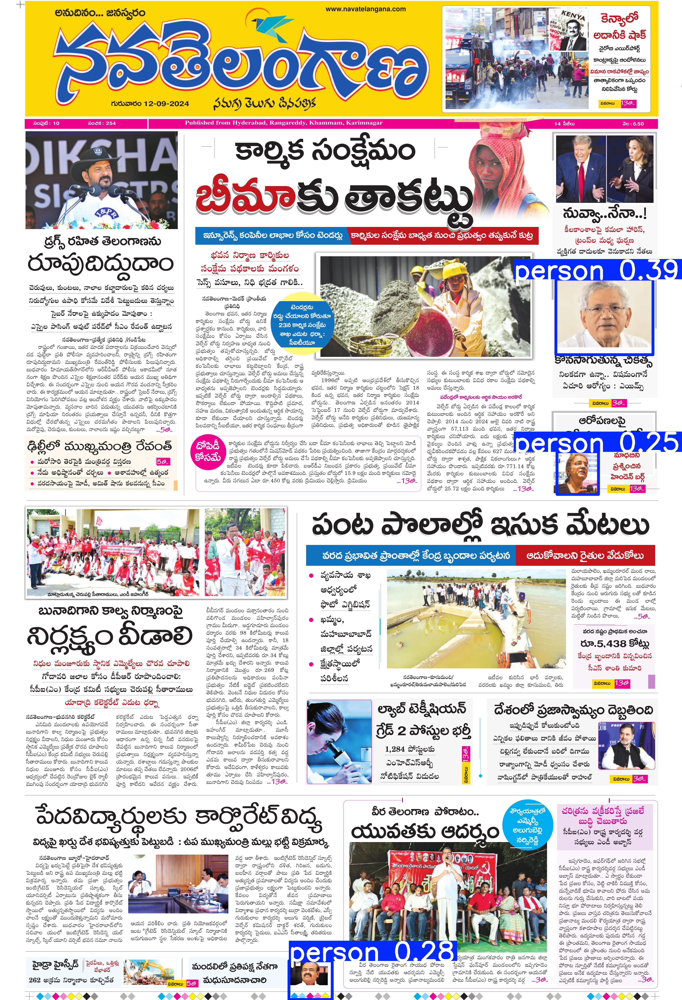

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/predict/NAVA_TELANGANA_12-09-2024.jpg', width=600)

# SDK

**NOTE:** YOLO's Python interface allows for seamless integration into your Python projects, making it easy to load, run, and process the model's output.

In [ ]:
from ultralytics import YOLO
from PIL import Image

model = YOLO('yolo11n.pt')
image = Image.open('/content/NAVA_TELANGANA_12-09-2024.jpg')
result = model.predict(image, conf=0.25)[0]


0: 640x448 3 persons, 114.6ms
Speed: 6.3ms preprocess, 114.6ms inference, 368.2ms postprocess per image at shape (1, 3, 640, 448)


**NOTE:** The obtained result object stores information about the location, classes, and confidence levels of the detected objects.

In [ ]:
result.boxes.xyxy

tensor([[3417.5759, 1714.6980, 4014.0308, 2178.1541],
        [1776.7413, 5901.2559, 2042.5280, 6138.9941],
        [3424.1770, 2774.7019, 3679.6538, 3036.4487]], device='cuda:0')

In [ ]:
result.boxes.conf

tensor([0.3881, 0.2751, 0.2541], device='cuda:0')

In [ ]:
result.boxes.cls

tensor([0., 0., 0.], device='cuda:0')

**NOTE:** YOLO11 can be easily integrated with supervision using the familiar from_ultralytics connector.

In [ ]:
import supervision as sv

detections = sv.Detections.from_ultralytics(result)

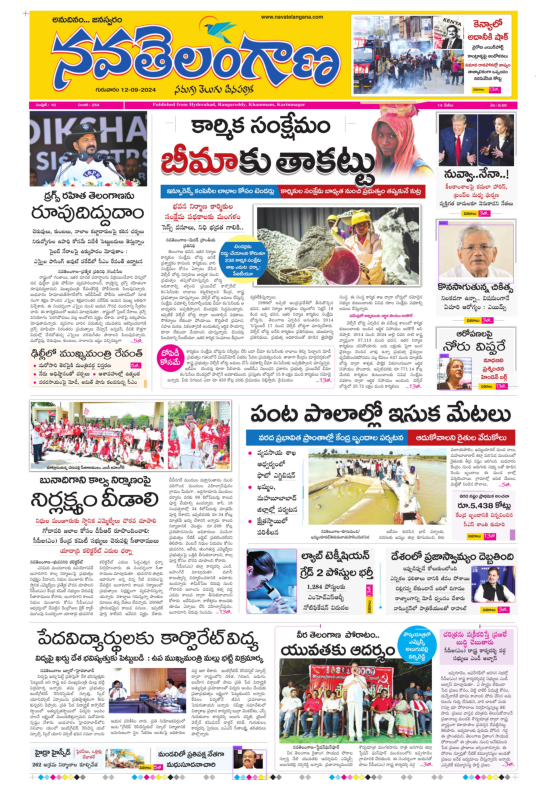

In [ ]:
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK)

annotated_image = image.copy()
annotated_image = box_annotator.annotate(annotated_image, detections=detections)
annotated_image = label_annotator.annotate(annotated_image, detections=detections)

sv.plot_image(annotated_image, size=(10, 10))

# Fine-tune YOLO11 on custom dataset

**NOTE:** When training YOLOv11, make sure your data is located in datasets. If you'd like to change the default location of the data you want to use for fine-tuning, you can do so through Ultralytics' settings.json. In this tutorial, we will use one of the datasets available on Roboflow Universe. When downloading, make sure to select the yolov11 export format.

In [ ]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

from google.colab import userdata
from roboflow import Roboflow

# ROBOFLOW_API_KEY = userdata.get('csNVQ6kkdgzTU6rKRr3V')
rf = Roboflow(api_key='csNVQ6kkdgzTU6rKRr3V')

workspace = rf.workspace("koni-9lsug")
project = workspace.project("extraction-kzuf3")
version = project.version(7)
dataset = version.download("yolov11")

mkdir: cannot create directory ‘/content/datasets’: File exists
/content/datasets
loading Roboflow workspace...
loading Roboflow project...


# **Custom Training**

In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolo11s.pt data={dataset.location}/data.yaml epochs=10 imgsz=640 plots=True

/content
New https://pypi.org/project/ultralytics/8.3.74 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/datasets/EXTRACTION-7/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, 

**NOTE:** The results of the completed training are saved in {HOME}/runs/detect/train/. Let's examine them.

In [ ]:
!ls {HOME}/runs/detect/train/

args.yaml					    model_artifacts.json  state_dict.pt
confusion_matrix_normalized.png			    P_curve.png		  train_batch0.jpg
confusion_matrix.png				    PR_curve.png	  train_batch1.jpg
events.out.tfevents.1739334643.1f9676964c25.2579.0  R_curve.png		  train_batch2.jpg
F1_curve.png					    results.csv		  val_batch0_labels.jpg
labels_correlogram.jpg				    results.png		  val_batch0_pred.jpg
labels.jpg					    roboflow_deploy.zip   weights


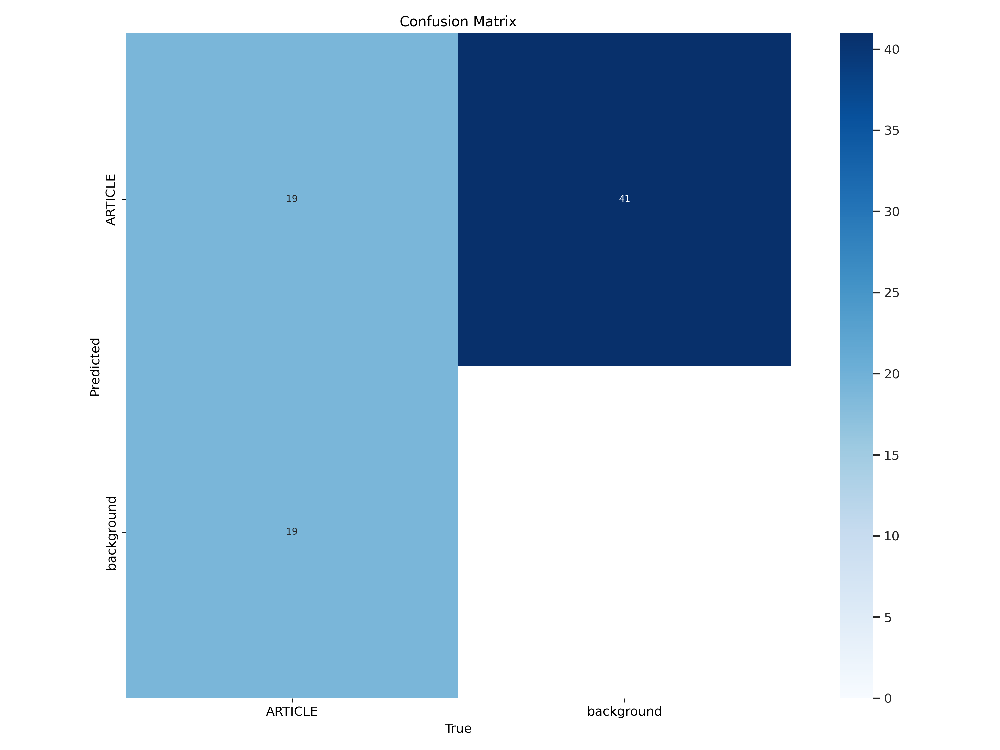

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

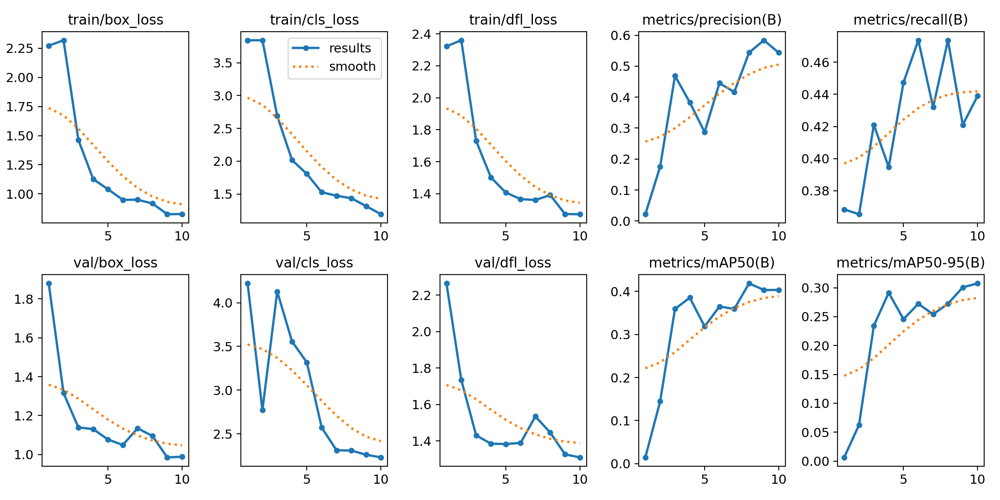

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/train/results.png', width=600)

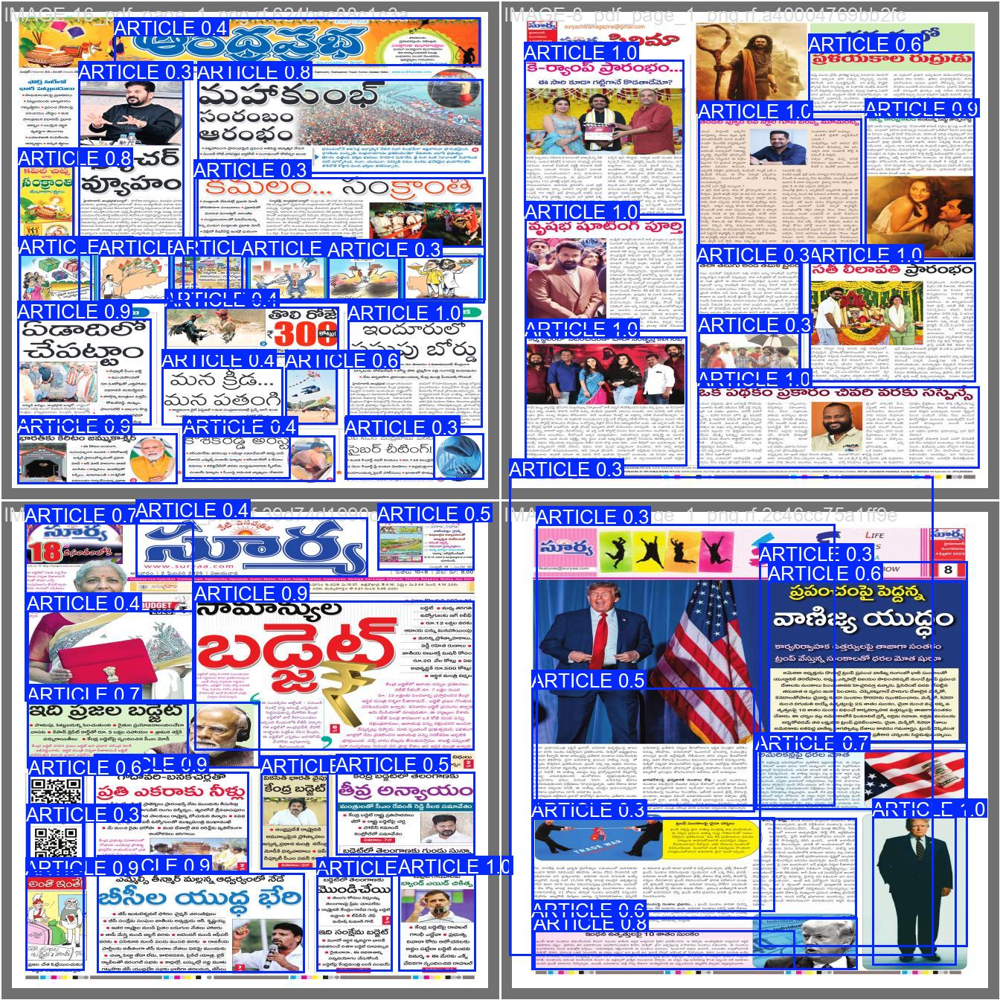

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

# **Validate fine-tuned model**

In [ ]:
!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics 8.3.40 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 238 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs
val: Scanning /content/datasets/EXTRACTION-7/valid/labels.cache... 4 images, 0 backgrounds, 0 corrupt: 100% 4/4 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 18, len(boxes) = 38. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 1/1 [00:00<00:00,  2.39it/s]
                   all          4         38      0.543      0.439      0.404      0.309
Speed: 0.5ms preprocess, 21.3ms inference, 0.0ms loss, 48.3ms postprocess per image
Results saved to runs/detect/val2
💡 Learn more at https://docs.ultralytics.com/modes/val


# **Inference with custom model**

In [ ]:
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.40 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 238 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs

image 1/5 /content/datasets/EXTRACTION-7/test/images/IMAGE-11_pdf_page_1_png.rf.3af4b21153dd5f00a30e9e0abef46632.jpg: 640x640 10 ARTICLEs, 15.6ms
image 2/5 /content/datasets/EXTRACTION-7/test/images/IMAGE-3_pdf_page_1_png.rf.9a3d2b3239fbceee4ffafec6012f9dfb.jpg: 640x640 16 ARTICLEs, 15.6ms
image 3/5 /content/datasets/EXTRACTION-7/test/images/NAVA_TELANGANA_17-01-2025.jpg: 640x448 25 ARTICLEs, 47.0ms
image 4/5 /content/datasets/EXTRACTION-7/test/images/NAVA_TELANGANA_27-01-2025.jpg: 640x448 23 ARTICLEs, 21.9ms
image 5/5 /content/datasets/EXTRACTION-7/test/images/NAVA_TELANGANA_29-01-2025.jpg: 640x448 25 ARTICLEs, 12.1ms
Speed: 3.8ms preprocess, 22.4ms inference, 30.5ms postprocess per image at shape (1, 3, 640, 448)
Results saved to runs/detect/predict5
💡 Learn more at https://docs.ultralytics.com/modes/predict


**NOTE:** Let's take a look at few results.

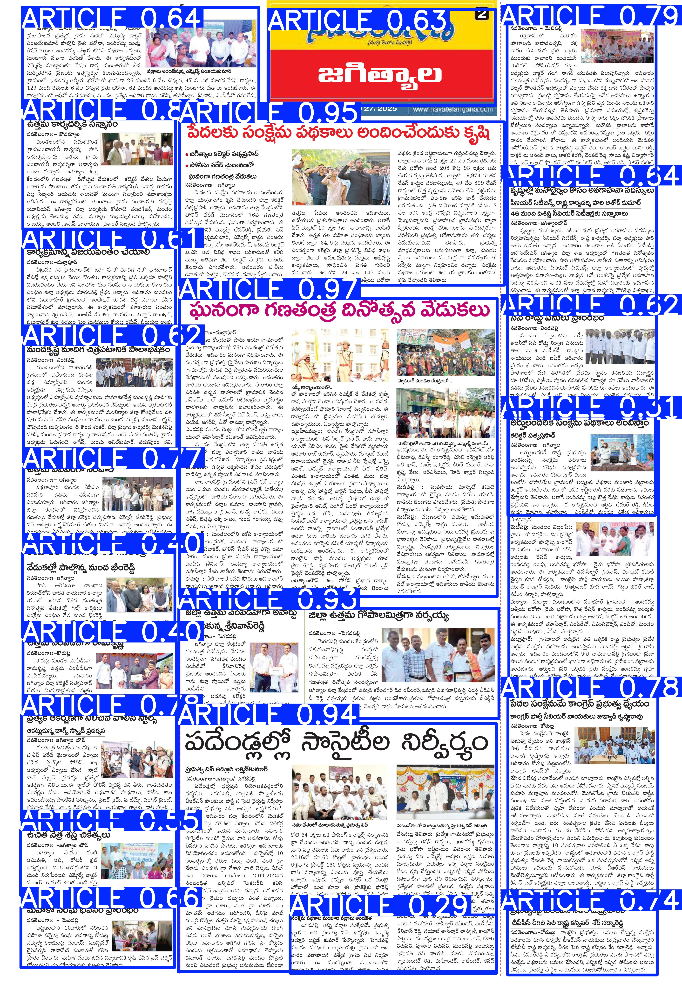

In [ ]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob(f'{HOME}/runs/detect/predict3*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[:3]:
    display(IPyImage(filename=img, width=600))
    print("\n")

# **Deploy model on Roboflow**

Once you have finished training your YOLOv11 model, you’ll have a set of trained weights ready for use. These weights will be in the /runs/detect/train/weights/best.pt folder of your project. You can upload your model weights to Roboflow Deploy to use your trained weights on our infinitely scalable infrastructure.

The .deploy() function in the Roboflow pip package now supports uploading YOLOv11 weights.

In [ ]:
project.version(dataset.version).deploy(model_type="yolov11", model_path=f"{HOME}/runs/detect/train/")

In [ ]:
!pip install inference

In [ ]:
import os, random, cv2
import supervision as sv
import IPython
import inference

model_id = project.id.split("/")[1] + "/" + dataset.version
model = inference.get_model(model_id, api_key='csNVQ6kkdgzTU6rKRr3V' )

# Location of test set images
test_set_loc = dataset.location + "/test/images/"
test_images = os.listdir(test_set_loc)

# Run inference on 4 random test images, or fewer if fewer images are available
for img_name in random.sample(test_images, min(4, len(test_images))):
    print("Running inference on " + img_name)

    # Load image
    image = cv2.imread(os.path.join(test_set_loc, img_name))

    # Perform inference
    results = model.infer(image, confidence=0.4, overlap=30)[0]
    detections = sv.Detections.from_inference(results)

    # Annotate boxes and labels
    box_annotator = sv.BoxAnnotator()
    label_annotator = sv.LabelAnnotator()
    annotated_image = box_annotator.annotate(scene=image, detections=detections)
    annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections)

    # Display annotated image
    _, ret = cv2.imencode('.jpg', annotated_image)
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)


**🏆 Congratulations**

**Learning Resources**

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- **Roboflow Notebooks:** A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- **Roboflow YouTube:** Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- **Roboflow Discuss:** Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- **Roboflow Models:** Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

**Convert data formats**

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out Roboflow Formats to find tutorials on how to convert data between formats in a few clicks.

**Connect computer vision to your project logic**

Roboflow Templates is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.

# **DEPLOYEMENT**

In [ ]:
import roboflow

rf = roboflow.Roboflow(api_key='csNVQ6kkdgzTU6rKRr3V')
project = rf.workspace().project("extraction-kzuf3")

#can specify weights_filename, default is "weights/best.pt"
version = project.version(7)
# version.deploy("model-type", "path/to/training/results/", "weights_filename")

#example1 - directory path is "training1/model1.pt" for yolov8 model
version.deploy("yolov11", "/content/runs/detect/train/weights", "best.pt")

#example2 - directory path is "training1/weights/best.pt" for yolov8 model
version.deploy("yolov11", "/content/runs/detect/train/weights/best.pt")

**MODEL DOWNLOADING**

In [ ]:
import roboflow

rf = roboflow.Roboflow(api_key="csNVQ6kkdgzTU6rKRr3V")
model = rf.workspace().project("extraction-kzuf3").version("7").model
prediction = model.download()